In [1]:
from player import player_1, player_2
from ultimatum import ultimatum
import plotly.express as px
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd

## Game

In [2]:
endowment = 100
epsilon = 0.1
alpha = 0.2
policy = 0.2

In [3]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate = alpha,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate = alpha,states = endowment)

game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [4]:
game.play()x
game.results

,A's offer,B's action,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0,0,0,0
1,0,1,100,0,100,0
2,0,0,0,0,100,0
3,33,0,0,0,100,0
4,0,0,0,0,100,0
...,...,...,...,...,...,...
9995,7,1,93,7,703689,160711
9996,7,1,93,7,703782,160718
9997,64,0,0,0,703782,160718
9998,7,1,93,7,703875,160725


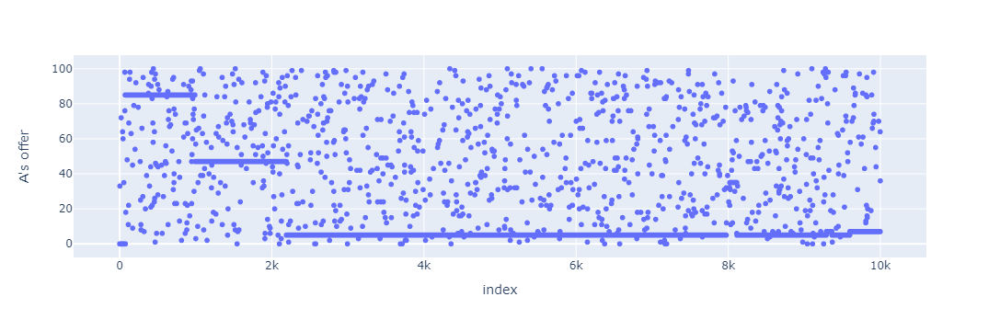

In [5]:
fig = px.scatter(game.results, y="A's offer")
fig.show()

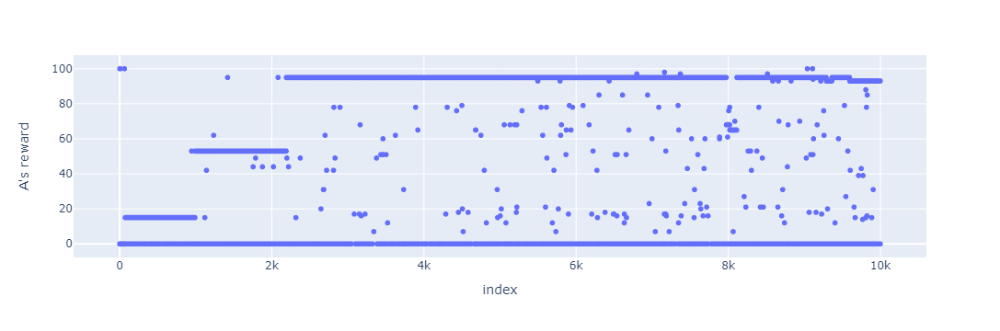

In [6]:
fig = px.scatter(game.results, y="A's reward")
fig.show()

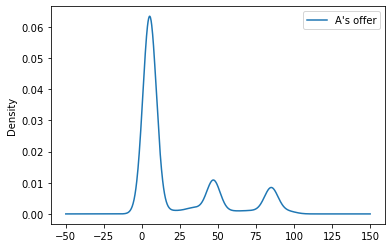

In [7]:
ax = game.results[["A's offer"]].plot.kde()

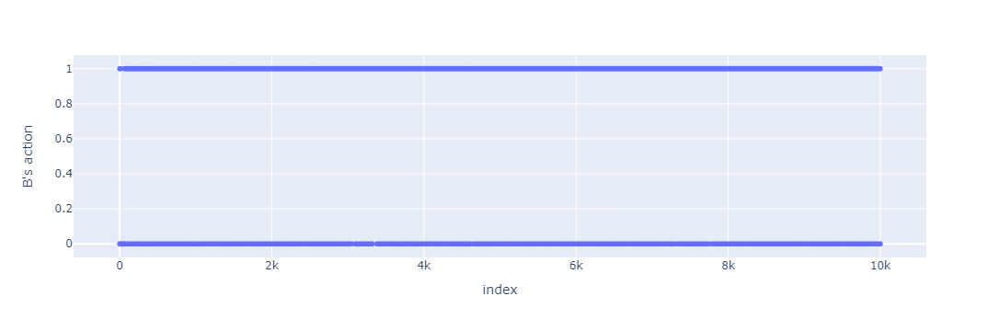

In [8]:
fig = px.scatter(game.results, y="B's action",size_max=0.0000001)
fig.show()

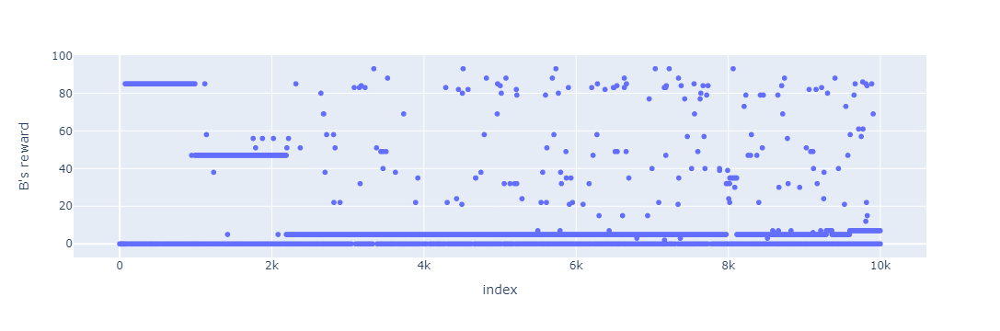

In [9]:
fig = px.scatter(game.results, y="B's reward")
fig.show()

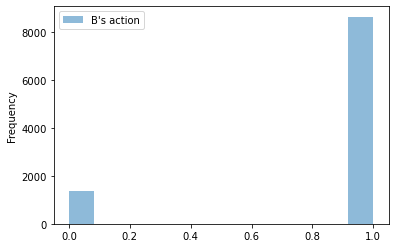

In [10]:
ax  = game.results[["B's action"]].plot.hist(bins=12, alpha=0.5)

### Exploring epsilon

In [20]:
endowment = 100
alpha = 0.2
n_simulations = 50
policy = 0.2

In [21]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = []

for epsilon in list([0.01,0.1,0.5,1]):
    
    agent_a_actions = []
    agent_b_actions = []
    agent_a_rewards = []
    agent_b_rewards = []

    for i in range(n_simulations):
        agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
        agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
        game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
        game.play()
        agent_a_actions.append(game.player_1_actions)
        agent_b_actions.append(game.player_2_actions)
        agent_a_rewards.append(game.player_1_rewards)
        agent_b_rewards.append(game.player_2_rewards)
    
    average_a_actions = np.mean(agent_a_actions, axis=0)
    average_a_actions_dynamic.append(average_a_actions)
    
    average_b_actions = np.mean(agent_b_actions, axis = 0)
    average_b_actions_dynamic.append(average_b_actions)
    
    average_a_rewards = np.mean(agent_a_rewards, axis = 0)
    average_a_rewards_dynamic.append(average_a_rewards)
    
    average_b_rewards = np.mean(agent_b_rewards, axis = 0)
    average_b_rewards_dynamic.append(average_b_rewards)
    
    names.append(f"epsilon = {epsilon}")

In [22]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

In [23]:
df_average_actions_a.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.00,4.24,19.80,54.66
1,1.76,4.74,27.32,49.22
2,0.00,1.16,24.92,49.60
3,0.00,6.68,32.66,47.44
4,0.00,10.44,30.56,49.52


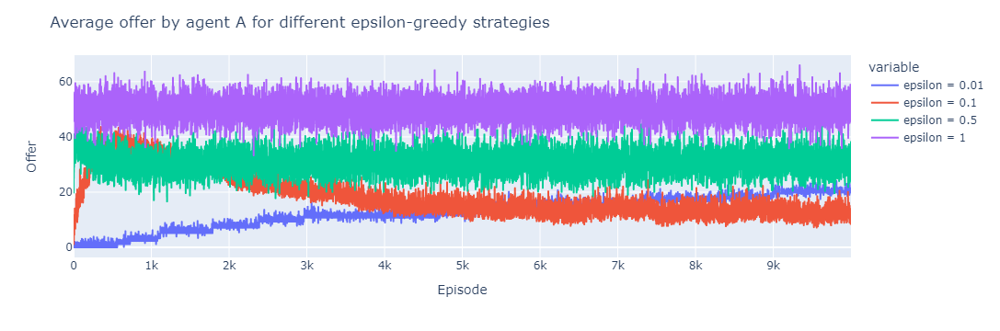

In [24]:
fig = px.line(df_average_actions_a,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"])
fig.update_layout(title = "Average offer by agent A for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

In [25]:
df_average_rewards_a.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.0,2.00,31.12,23.28
1,2.0,4.00,15.00,18.22
2,0.0,8.00,22.60,31.56
3,0.0,2.38,18.50,19.64
4,2.0,3.98,23.88,32.70


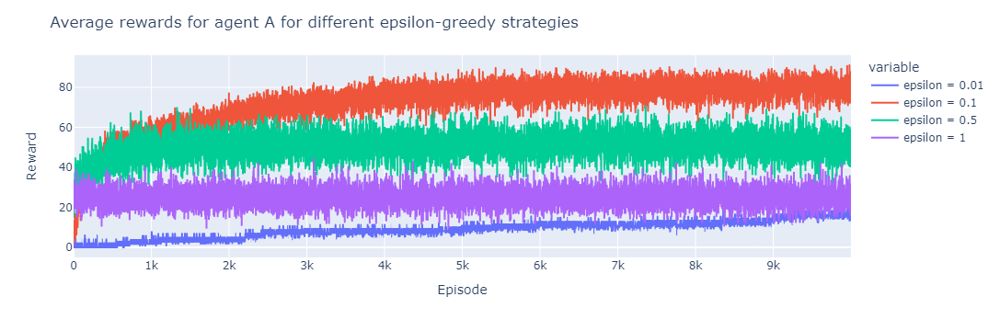

In [26]:
fig = px.line(df_average_rewards_a,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"])
fig.update_layout(title = "Average rewards for agent A for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

In [27]:
df_average_actions_b.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.00,0.02,0.40,0.48
1,0.02,0.04,0.24,0.44
2,0.00,0.08,0.34,0.60
3,0.00,0.04,0.30,0.42
4,0.02,0.08,0.40,0.48


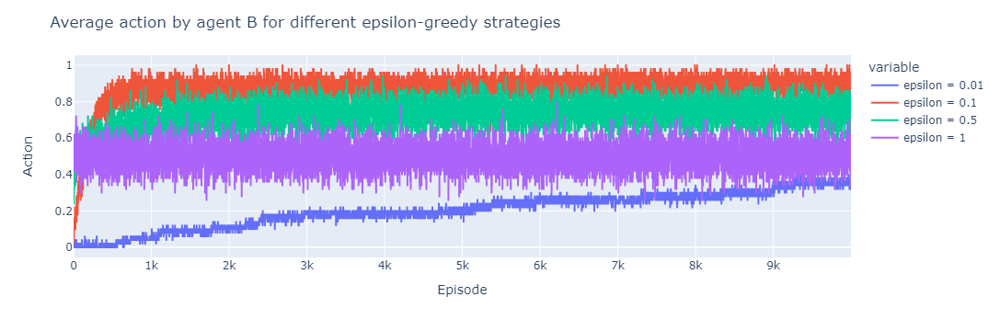

In [28]:
fig = px.line(df_average_actions_b,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"])
fig.update_layout(title = "Average action by agent B for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

In [29]:
df_average_rewards_b.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.0,0.00,8.88,24.72
1,0.0,0.00,9.00,25.78
2,0.0,0.00,11.40,28.44
3,0.0,1.62,11.50,22.36
4,0.0,4.02,16.12,15.30


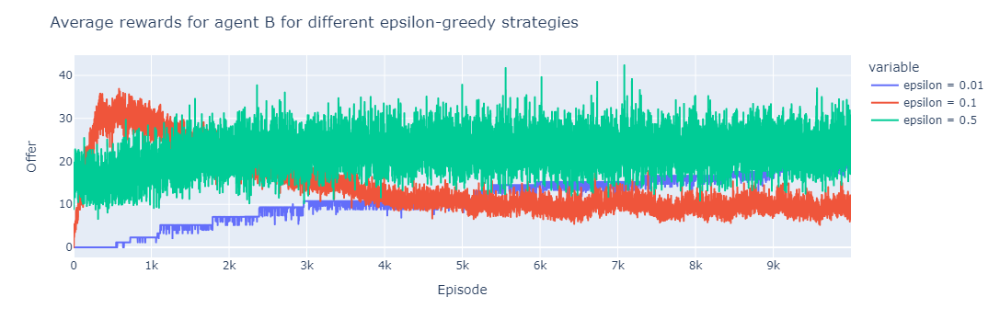

In [33]:
fig = px.line(df_average_rewards_b,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5"])
fig.update_layout(title = "Average rewards for agent B for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

### Exploring alpha

In [2]:
endowment = 100
epsilon = 0.1
n_simulations = 50
policy = 0.2

In [3]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = []

for alpha in list([0.01,0.1,0.5,1]):
    
    agent_a_actions = []
    agent_b_actions = []
    agent_a_rewards = []
    agent_b_rewards = []

    for i in range(n_simulations):
        agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
        agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
        game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
        game.play()
        agent_a_actions.append(game.player_1_actions)
        agent_b_actions.append(game.player_2_actions)
        agent_a_rewards.append(game.player_1_rewards)
        agent_b_rewards.append(game.player_2_rewards)
    
    average_a_actions = np.mean(agent_a_actions, axis=0)
    average_a_actions_dynamic.append(average_a_actions)
    
    average_b_actions = np.mean(agent_b_actions, axis = 0)
    average_b_actions_dynamic.append(average_b_actions)
    
    average_a_rewards = np.mean(agent_a_rewards, axis = 0)
    average_a_rewards_dynamic.append(average_a_rewards)
    
    average_b_rewards = np.mean(agent_b_rewards, axis = 0)
    average_b_rewards_dynamic.append(average_b_rewards)
    
    names.append(f"alpha = {alpha}")

In [4]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

In [5]:
df_average_actions_a.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,2.38,7.38,10.42,3.30
1,1.80,4.34,7.82,7.82
2,1.88,6.96,3.80,3.80
3,7.68,5.70,5.66,10.16
4,2.76,6.36,6.68,6.74


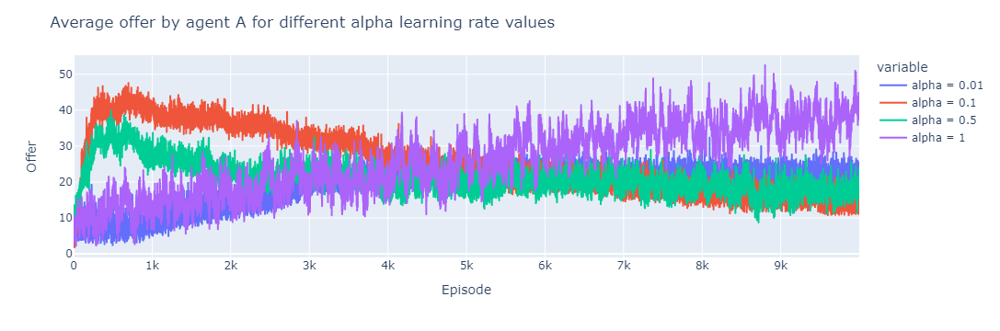

In [6]:
fig = px.line(df_average_actions_a,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average offer by agent A for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

In [7]:
df_average_rewards_a.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,10.00,4.26,8.0,3.18
1,10.00,2.26,2.0,1.18
2,0.00,10.26,8.0,6.08
3,7.92,2.26,6.0,4.08
4,9.92,2.26,2.0,6.08


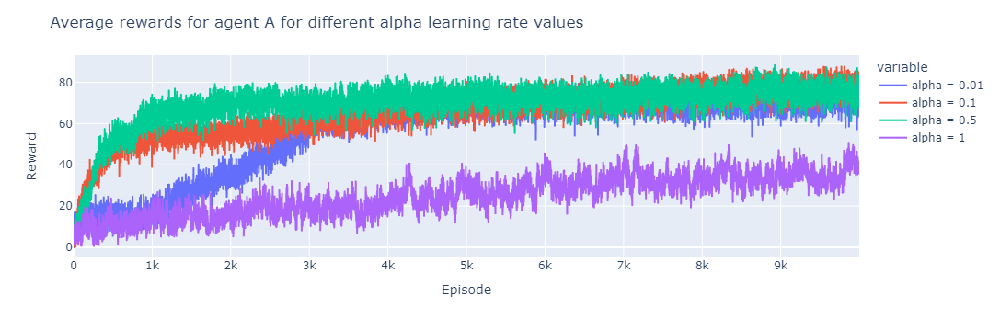

In [8]:
fig = px.line(df_average_rewards_a,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average rewards for agent A for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

In [9]:
df_average_actions_b.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.10,0.06,0.08,0.04
1,0.10,0.04,0.02,0.02
2,0.00,0.12,0.08,0.08
3,0.08,0.04,0.06,0.06
4,0.10,0.04,0.02,0.08


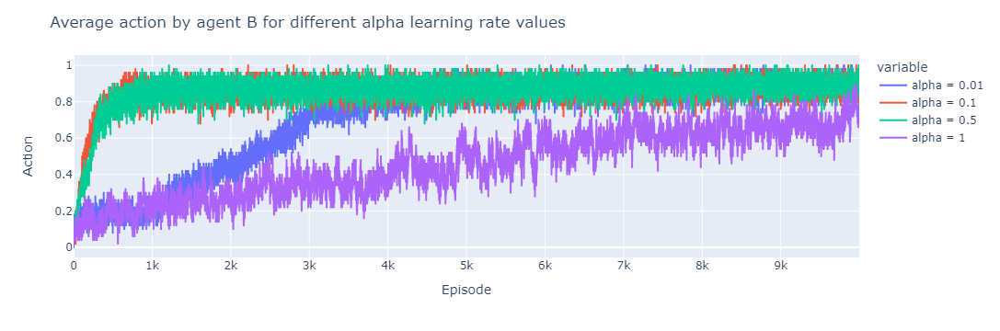

In [10]:
fig = px.line(df_average_actions_b,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average action by agent B for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

In [11]:
df_average_rewards_b.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.00,1.74,0.0,0.82
1,0.00,1.74,0.0,0.82
2,0.00,1.74,0.0,1.92
3,0.08,1.74,0.0,1.92
4,0.08,1.74,0.0,1.92


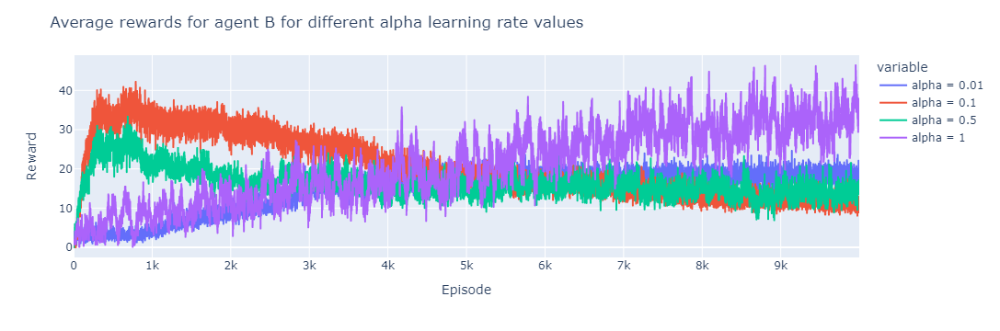

In [14]:
fig = px.line(df_average_rewards_b,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average rewards for agent B for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

### New game with best parameters for each player

In [15]:
endowment = 100
epsilon = 0.1
alpha_a = 0.5
alpha_b = 1
policy = 0.2

In [16]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha_a,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha_b,states = endowment)

game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [17]:
game.play()
game.results

,A's offer,B's action,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0,0,0,0
1,61,0,0,0,0,0
2,0,0,0,0,0,0
3,0,0,0,0,0,0
4,0,0,0,0,0,0
...,...,...,...,...,...,...
9995,17,1,83,17,712962,168638
9996,17,1,83,17,713045,168655
9997,17,1,83,17,713128,168672
9998,17,1,83,17,713211,168689


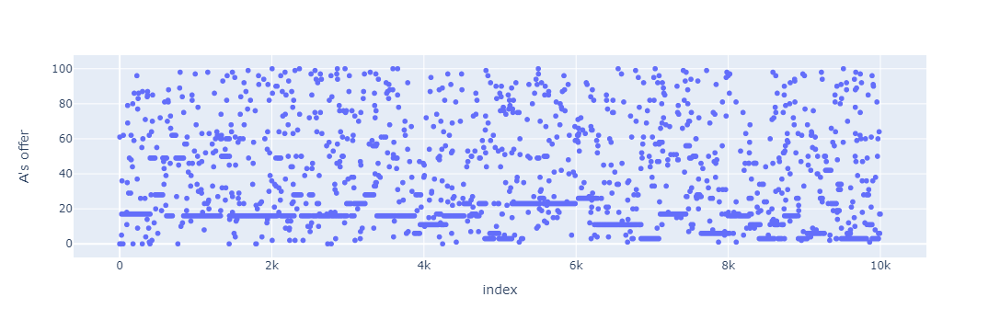

In [18]:
fig = px.scatter(game.results, y="A's offer")
fig.show()

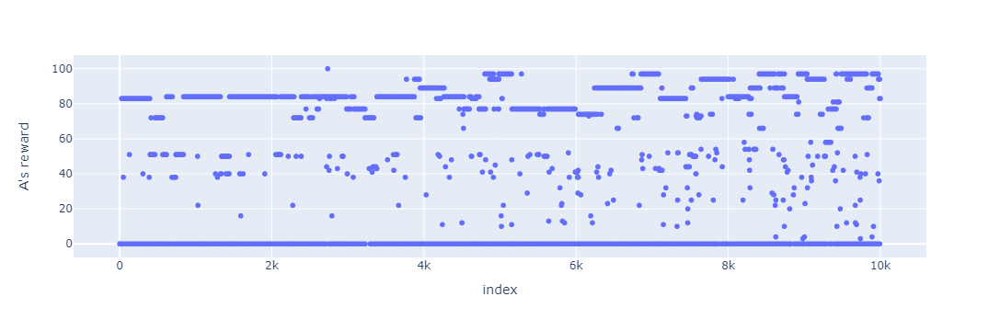

In [24]:
fig = px.scatter(game.results, y="A's reward")
fig.show()

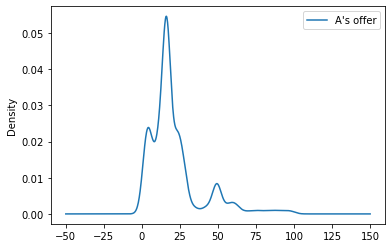

In [20]:
ax = game.results[["A's offer"]].plot.kde()

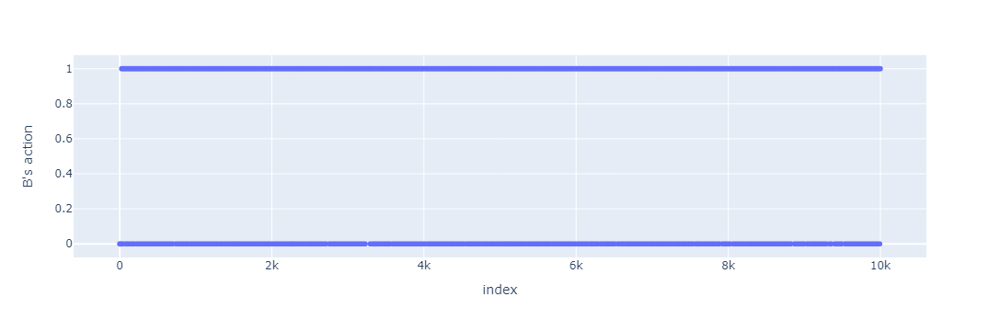

In [19]:
fig = px.scatter(game.results, y="B's action",size_max=0.0000001)
fig.show()

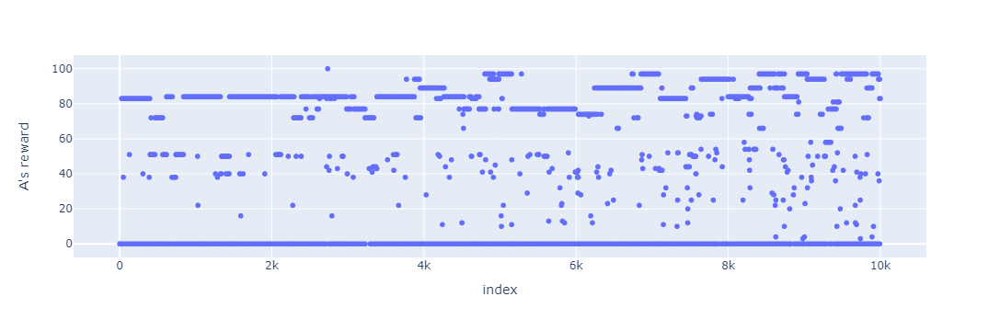

In [24]:
fig = px.scatter(game.results, y="B's reward")
fig.show()

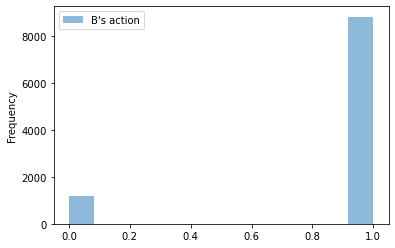

In [21]:
ax  = game.results[["B's action"]].plot.hist(bins=12, alpha=0.5)

### Fixed rules

In [2]:
endowment = 100
epsilon = 0.1
alpha_a = 0.5
alpha_b = 1
policy = 0.2

In [3]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha_a,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha_b,states = endowment)

In [4]:
from types import MethodType

In [5]:
def move_fixed_policy(self, state, p):
    endowment = self.states
    if state > p*endowment:
        action = 1
    else:
        action = 0 
    return action

agent_b.move = MethodType(move_fixed_policy,agent_b)

In [6]:
game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [7]:
game.play()
game.results

,A's offer,B's action,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0,0,0,0
1,0,0,0,0,0,0
2,0,0,0,0,0,0
3,0,0,0,0,0,0
4,0,0,0,0,0,0
...,...,...,...,...,...,...
9995,21,1,79,21,731384,246516
9996,21,1,79,21,731463,246537
9997,90,1,10,90,731473,246627
9998,21,1,79,21,731552,246648


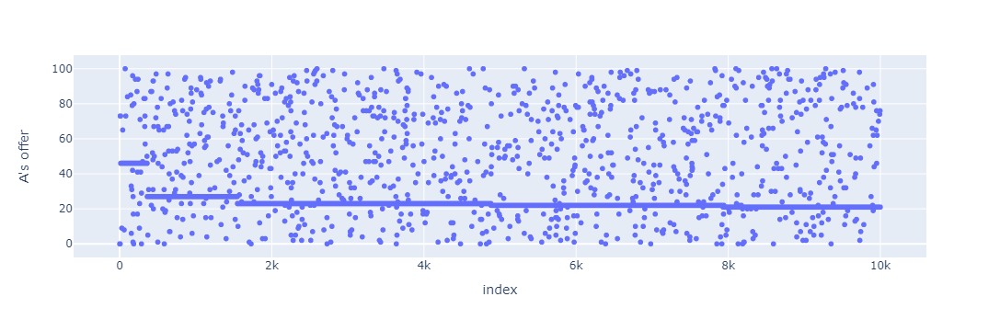

In [10]:
fig = px.scatter(game.results, y="A's offer")
fig.show()

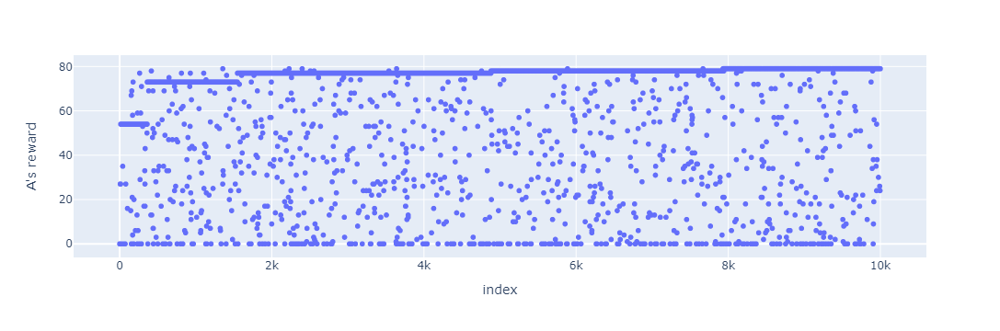

In [11]:
fig = px.scatter(game.results, y="A's reward")
fig.show()

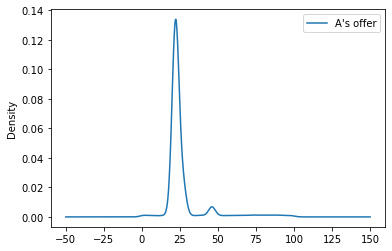

In [12]:
ax = game.results[["A's offer"]].plot.kde()

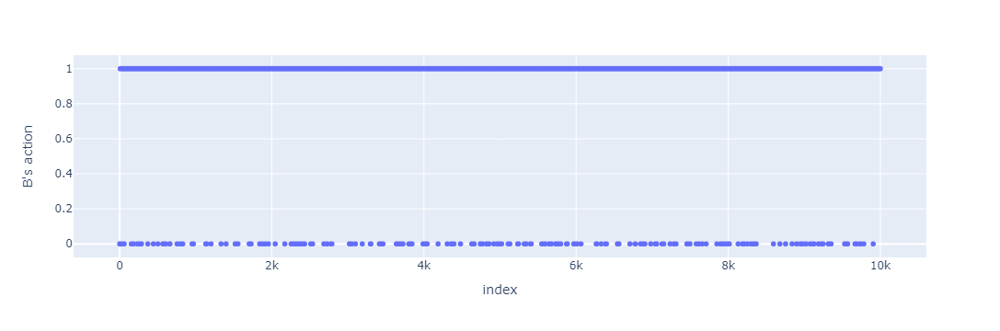

In [13]:
fig = px.scatter(game.results, y="B's action",size_max=0.0000001)
fig.show()

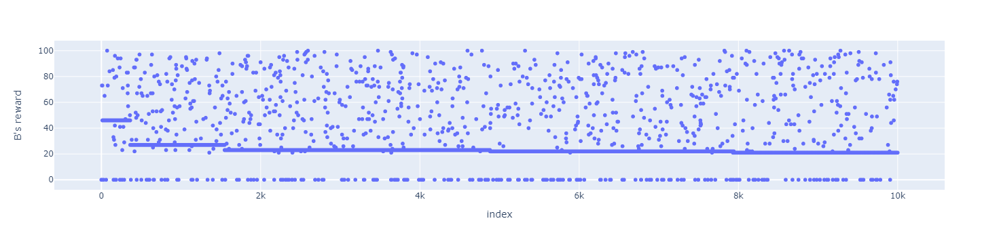

In [14]:
fig = px.scatter(game.results, y="B's reward")
fig.show()

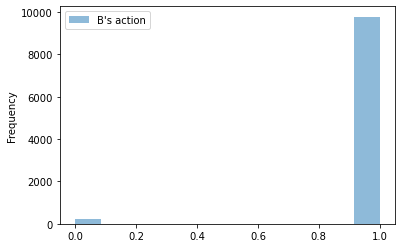

In [15]:
ax  = game.results[["B's action"]].plot.hist(bins=12, alpha=0.5)

### Dynamic Rules

In [2]:
endowment = 100
epsilon = 0.1
alpha_a = 0.5
alpha_b = 1
policy = 0.4

In [3]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha_a,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha_b,states = endowment)

In [4]:
from types import MethodType

In [5]:
def move_fixed_policy(self, state, p):
    endowment = self.states
    if state > p*endowment:
        action = 1
    else:
        action = 0 
    return action

agent_b.move = MethodType(move_fixed_policy,agent_b)

In [6]:
game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [7]:
game.play(dynamic = True)
game.results

,A's offer,B's action,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0,0,0,0
1,0,0,0,0,0,0
2,0,0,0,0,0,0
3,0,0,0,0,0,0
4,93,1,7,93,7,93
...,...,...,...,...,...,...
9995,61,1,39,61,470233,479767
9996,61,1,39,61,470272,479828
9997,61,1,39,61,470311,479889
9998,61,1,39,61,470350,479950


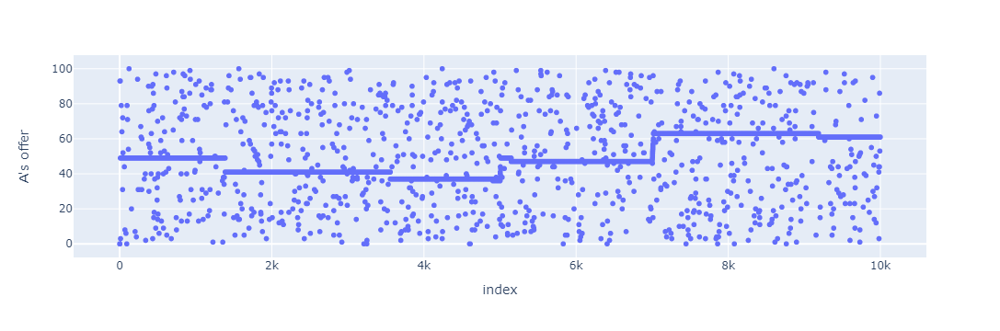

In [8]:
fig = px.scatter(game.results, y="A's offer")
fig.show()

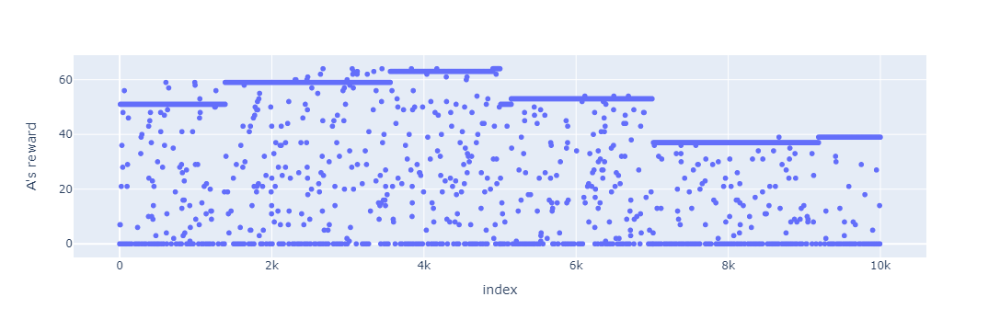

In [9]:
fig = px.scatter(game.results, y="A's reward")
fig.show()

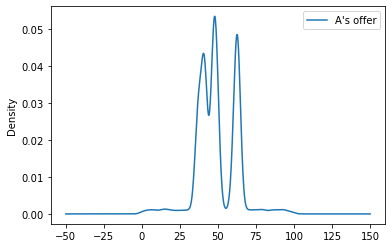

In [10]:
ax = game.results[["A's offer"]].plot.kde()

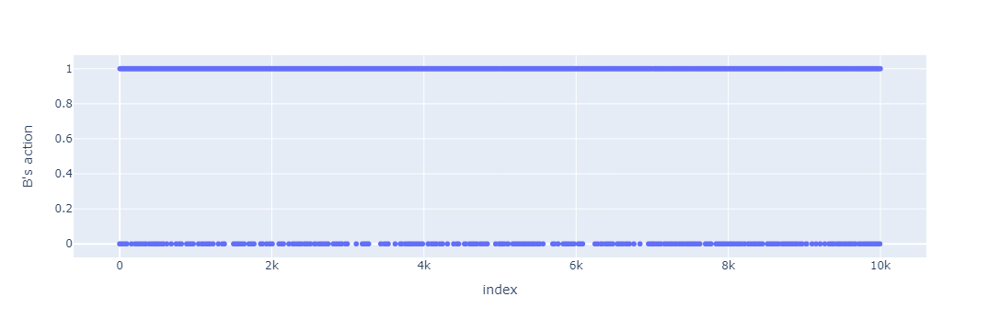

In [11]:
fig = px.scatter(game.results, y="B's action",size_max=0.0000001)
fig.show()

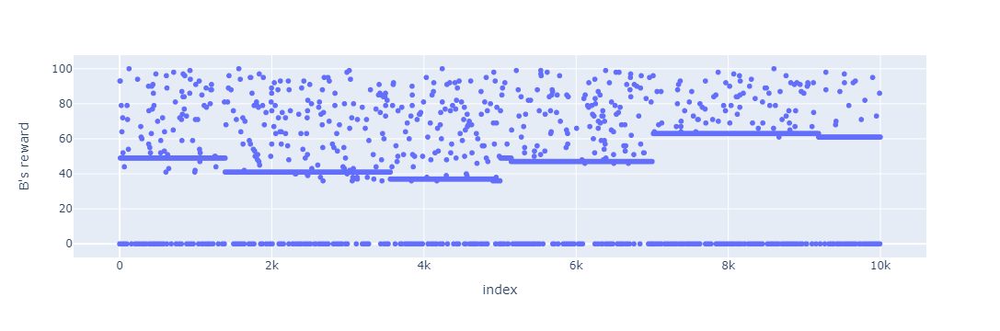

In [12]:
fig = px.scatter(game.results, y="B's reward")
fig.show()

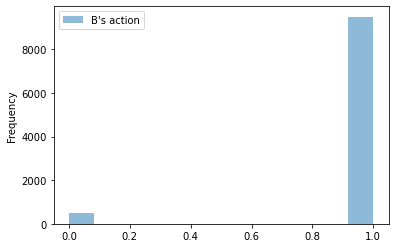

In [13]:
ax  = game.results[["B's action"]].plot.hist(bins=12, alpha=0.5)

## Development

In [7]:
import numpy as np

In [17]:
x = np.zeros(shape = (1,50))
x[0][45] = 8
print(x)

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 8. 0. 0.
  0. 0.]]


In [18]:
a = list(x[0]).index(max(x[0]))
a

45

In [13]:
a = list(x[0]).index(6)
a

AttributeError: 'numpy.ndarray' object has no attribute 'type'

In [5]:
x = np.random.randint(low = 0, high = 50)
x

40

In [16]:
class dog:
    b = 0

In [17]:
maxi = dog()
print(maxi.b)

0


In [18]:
maxi.b = 58

In [14]:
name = {20:0.35,35:0.45,50:0.6,100:0.4}
name.keys()

dict_keys([20, 35, 50, 100])

In [16]:
name = {20:0.35,35:0.45,50:0.6,100:0.4}
x = 0
for i in range(100):
    if i in name.keys():
        x = name[i]
    print(x)

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6


In [9]:
def start(x, *args,**kwargs):
    if line == 1:
        print(x)
    
start(x = "this is a test",line = 0)

NameError: name 'line' is not defined